In [72]:
import requests
from PIL import Image
from transformers import BlipProcessor, BlipForQuestionAnswering
import torch

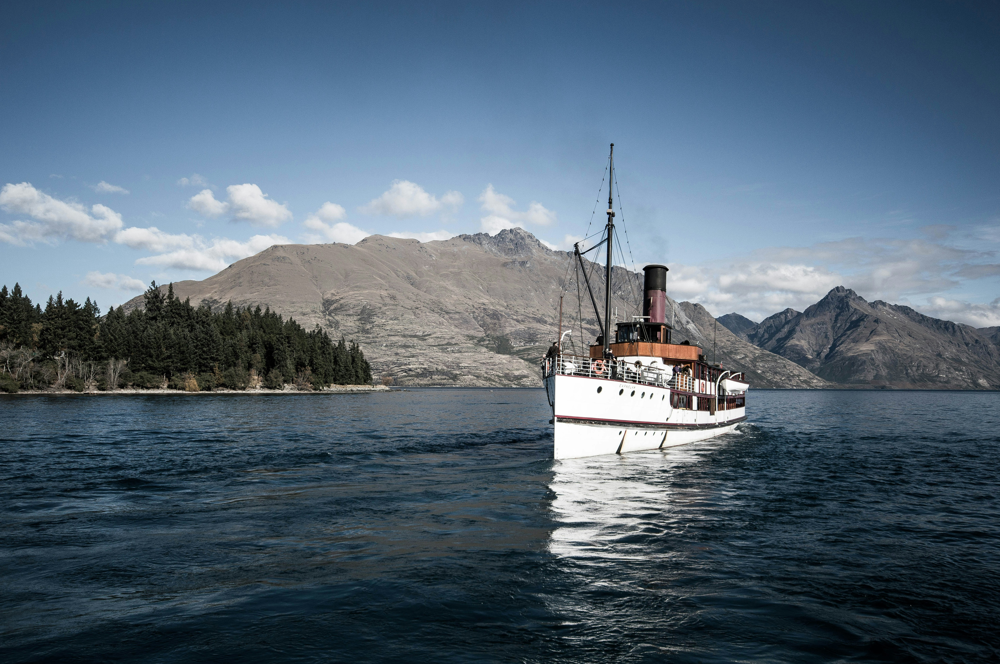

In [73]:
# load the image we will test BLIP on
img_path = './stephen-crowley-jp8fyq11VIU-unsplash.jpg'
image = Image.open(img_path).convert('RGB')
image


In [74]:
# load necessary components: the processor and the model
processor = BlipProcessor.from_pretrained("Salesforce/blip-vqa-base")
model = BlipForQuestionAnswering.from_pretrained("Salesforce/blip-vqa-base")

In [75]:
def get_answer_blip(model, processor, image, question):
    """Answers the given question and handles all the preprocessing and postprocessing steps"""
    # preprocess the given image and question
    inputs = processor(image, question, return_tensors="pt")
    # generate the answer (get output)
    out = model.generate(**inputs)
    # post-process the output to get human friendly english text
    print(processor.decode(out[0], skip_special_tokens=True))
    return

In [76]:
# sample question 1
question = "how many objects are in the picture?"
get_answer_blip(model, processor, image, question)

one


In [85]:
question = "describe all the objects in the picture?"
get_answer_blip(model, processor, image, question)

boat and mountains


In [78]:
# sample question 2
question = "how will you describe the picture?"
get_answer_blip(model, processor, image, question)

boat in water


In [79]:
# sample question 3
question = "where are it?"
get_answer_blip(model, processor, image, question)

in water


In [80]:
question = "what time is it ?"
get_answer_blip(model, processor, image, question)

afternoon


In [81]:
question = "what weather is it ?"
get_answer_blip(model, processor, image, question)

sunny


In [82]:
question = "how many ships are in the water?"
get_answer_blip(model, processor, image, question)

one


In [83]:
question = "what color is the ship?"
get_answer_blip(model, processor, image, question)

white


In [84]:
question = "is it a passenger ship or a cargo ship?"
get_answer_blip(model, processor, image, question)

passenger
